<a href="https://colab.research.google.com/github/m-majchrzak/Image_Generation_with_GANs/blob/main/DCGAN64_fid_interpolation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Envoirment setup

In [1]:
%cd /content/
!rm -r ./Image_Generation_with_GANs/
!git clone https://github.com/m-majchrzak/Image_Generation_with_GANs.git
%cd Image_Generation_with_GANs/

/content
rm: cannot remove './Image_Generation_with_GANs/': No such file or directory
Cloning into 'Image_Generation_with_GANs'...
remote: Enumerating objects: 69, done.
remote: Counting objects: 100% (69/69), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 69 (delta 30), reused 39 (delta 15), pack-reused 0
Unpacking objects: 100% (69/69), 36.45 MiB | 9.02 MiB/s, done.
/content/Image_Generation_with_GANs


In [2]:
#!pip install -r requirements.txt
!pip install -U -q pyunpack

In [3]:
!pip install wandb

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 22.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 206.7/206.7 kB 24.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.8 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8791 sha256=610596a51c7ab19f1c9e11f8b6c3c952d6b9a9bf031d3df1e46e7e4db063679e
  Stored in directory: /root/.cache/pip/wheels/e7/f3/22/152153d6eb222ee7a56ff8617d80ee5207207a8c00a7aab794
Successfully built pathtools


In [4]:
!pip install pytorch-fid

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [5]:
from utils.dataset import download_dataset
download_dataset("./data/sample")

9548134996/9548134996 [==============================] - 42s 0us/step


## DC-GAN
from tutorial: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html

In [10]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.optim as optim
import torch.utils.data
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from utils.utils import set_seeds
from utils.dataset import download_dataset
from models.DCGAN import weights_init, Generator, Discriminator
import wandb

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
set_seeds(manualSeed)



Random Seed:  999


In [11]:
# Root directory for dataset
dataroot = "data/sample/data0/lsun/bedroom/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 256

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [12]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

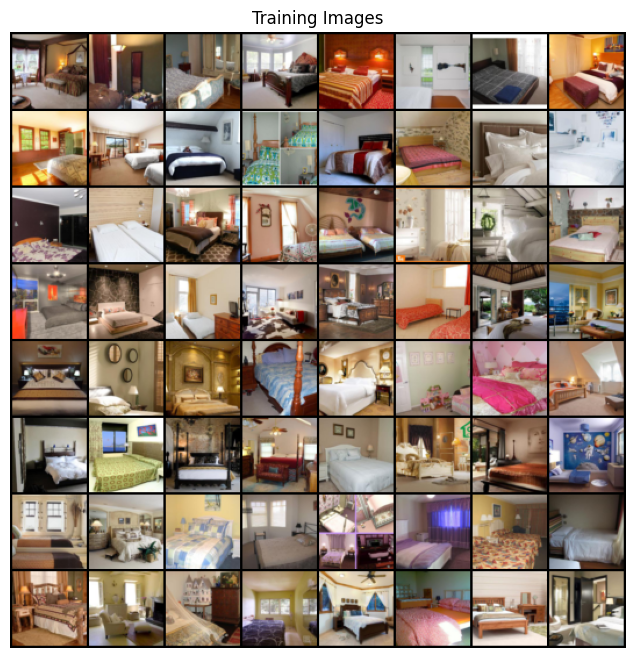

In [13]:
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [14]:
# Create the generator
netG = Generator(ngpu, nz, ngf, nc).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [15]:
# Create the Discriminator
netD = Discriminator(ngpu, nc, ndf).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [16]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [19]:
## wandb setup
wandb.init(
    # set the wandb project where this run will be logged
    project="image_generation_with_GANs",
    entity = 'wo-team',
    group = 'DCGAN64_final',
    name = "dcgan64x64_final"
    # track hyperparameters and run metadata
)

<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [20]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        wandb.log({"epoch":epoch, "g_loss": errG.item(), "d_loss": errD.item(), "D(x)": D_x, "D_G_z1": D_G_z1, "D_G_z2": D_G_z2})

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            ## save models for later evaluation
            torch.save(netD, f"weights/dcgan64_disc_iter_{iters}.pkl")
            torch.save(netG, f"weights/dcgan64_gen_iter_{iters}.pkl")

        iters += 1

Starting Training Loop...
[0/10][0/1185]	Loss_D: 1.6129	Loss_G: 5.7289	D(x): 0.5360	D(G(z)): 0.5253 / 0.0055
[0/10][50/1185]	Loss_D: 0.2675	Loss_G: 22.6781	D(x): 0.8639	D(G(z)): 0.0000 / 0.0000
[0/10][100/1185]	Loss_D: 2.9387	Loss_G: 4.2727	D(x): 0.1466	D(G(z)): 0.0017 / 0.0185
[0/10][150/1185]	Loss_D: 1.0428	Loss_G: 1.7454	D(x): 0.5243	D(G(z)): 0.2043 / 0.2084
[0/10][200/1185]	Loss_D: 0.7020	Loss_G: 4.9441	D(x): 0.9144	D(G(z)): 0.3923 / 0.0117
[0/10][250/1185]	Loss_D: 0.8328	Loss_G: 6.0625	D(x): 0.5252	D(G(z)): 0.0045 / 0.0039
[0/10][300/1185]	Loss_D: 0.3021	Loss_G: 4.0543	D(x): 0.8602	D(G(z)): 0.1151 / 0.0278
[0/10][350/1185]	Loss_D: 0.9634	Loss_G: 6.4706	D(x): 0.7597	D(G(z)): 0.4107 / 0.0032
[0/10][400/1185]	Loss_D: 0.2240	Loss_G: 4.4217	D(x): 0.9050	D(G(z)): 0.1040 / 0.0177
[0/10][450/1185]	Loss_D: 0.3982	Loss_G: 4.1028	D(x): 0.8318	D(G(z)): 0.1586 / 0.0248
[0/10][500/1185]	Loss_D: 0.2950	Loss_G: 5.6573	D(x): 0.9074	D(G(z)): 0.1235 / 0.0066
[0/10][550/1185]	Loss_D: 0.5772	Loss_G: 4

In [21]:
 wandb.finish()

D(x),▃▆▇▇▁▇▆██▇▆▆██▇▇▇▇▆▇▇▇▇▆▇▆▆█▇▆▇▇▇██▅█▆▇▄
D_G_z1,▂▂▄▃▁▂▄▃▇▃▃▃▅▄▃▄▃▃▄▃▃▂▃▂▂▂▃▆▃▃▃▄▃█▄▂▃▂▂▁
D_G_z2,▃▂▁▁▅▁▁▁▁▁▁▂▁▁▂▁▁▂▂▂▁▂▂▂▂▄▂▂▂▃▃▂▂▁▁▂▁▃▂█
d_loss,▄▁▂▂█▁▂▁▃▁▂▂▂▁▁▂▁▁▂▂▁▁▁▁▁▂▂▂▁▂▂▂▁▃▂▂▁▁▁▃
epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▃▄▄▄▄▅▅▅▅▆▆▆▆▆▆▆▆▇▇▇▇████
g_loss,▃▃▆▅▂▅▄▆█▅▄▃▆▅▄▄▄▃▃▄▅▃▄▃▃▂▃▄▃▂▃▄▄█▄▃▅▃▄▁
D(x),0.86932
D_G_z1,0.1404
D_G_z2,0.01938
d_loss,0.307
epoch,9


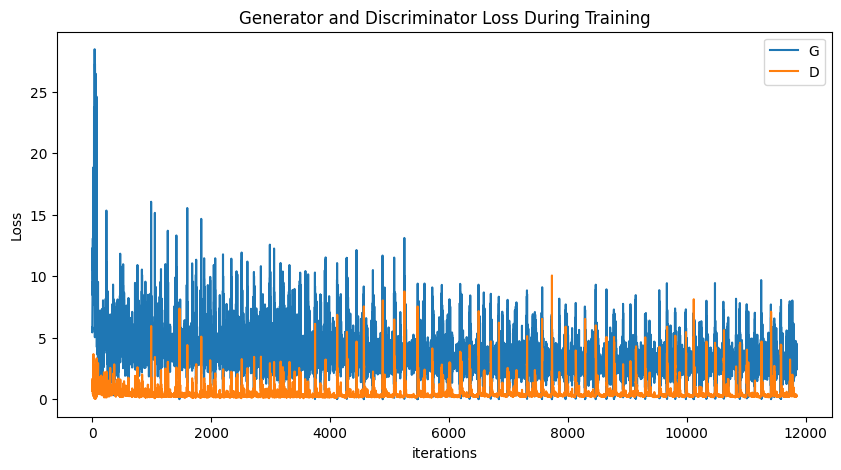

In [22]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

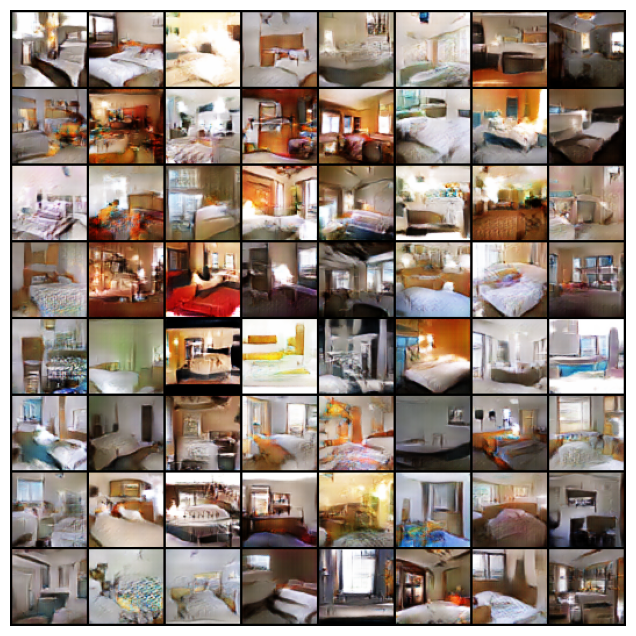

In [23]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

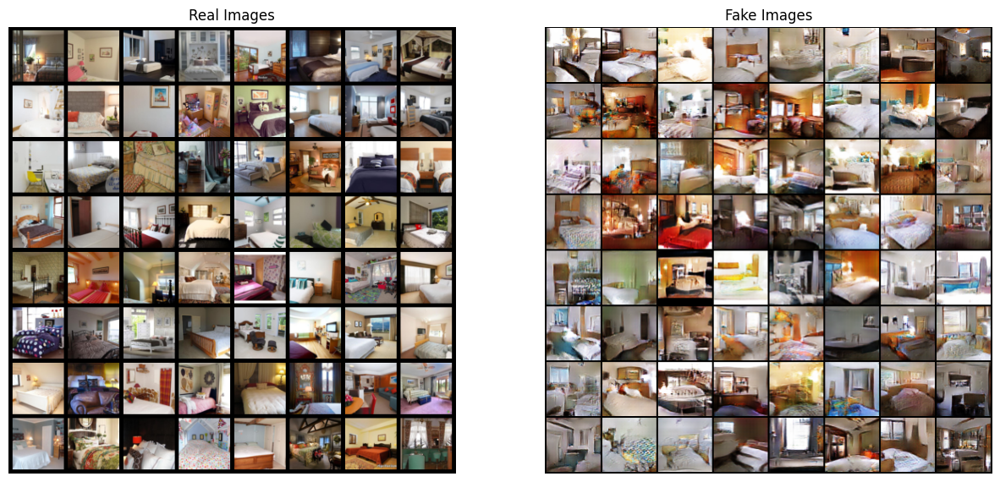

In [24]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Save images and calculate FID

In [25]:
fake.shape

torch.Size([64, 3, 64, 64])

In [27]:
for i, fake_img in enumerate(fake):
  torchvision.utils.save_image(fake_img, f"images/fake/{i}.jpg")

In [28]:
real_cpu.shape

torch.Size([21, 3, 64, 64])

In [29]:
for i, real_img in enumerate(real_cpu):
  torchvision.utils.save_image(real_img, f"images/real/{i}.jpg")

In [30]:
!python -m pytorch_fid "images/real" "images/fake"

Downloading: "https://github.com/mseitzer/pytorch-fid/releases/download/fid_weights/pt_inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/pt_inception-2015-12-05-6726825d.pth
100% 91.2M/91.2M [00:01<00:00, 77.1MB/s]
100% 1/1 [00:00<00:00,  2.30it/s]
100% 2/2 [00:00<00:00,  8.34it/s]
FID:  229.87076751904604


## Interpolation

In [31]:
noise = torch.randn(b_size, nz, 1, 1, device=device)


In [71]:
noise.shape

torch.Size([21, 100, 1, 1])

In [35]:
noise1=noise[1]

In [69]:
noise3=noise[3]

In [70]:
noise19=noise[19]

In [37]:
# Generate fake image batch with G
fake = netG(noise)

In [72]:
fake.shape

torch.Size([21, 3, 64, 64])

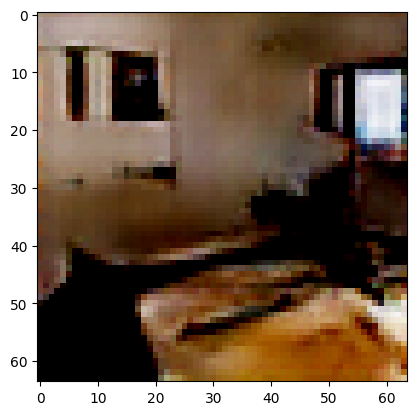

In [47]:
plt.imshow(np.transpose(fake[1].cpu().detach().numpy(),(1,2,0)))

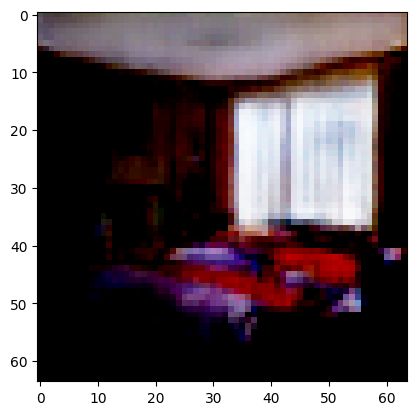

In [52]:
plt.imshow(np.transpose(fake[3].cpu().detach().numpy(),(1,2,0)))

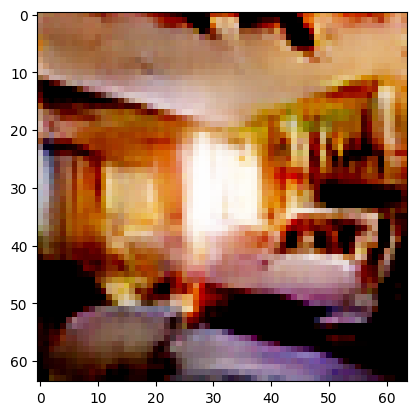

In [68]:
plt.imshow(np.transpose(fake[19].cpu().detach().numpy(),(1,2,0)))

In [96]:
lerp3_19 = torch.lerp(noise3, noise19, 0.5)

In [98]:
lerp3_19.shape

torch.Size([100, 1, 1])

In [99]:
def noise_interpolation8(start, end, weight=0.5):
  lerp5 = torch.lerp(start, end, weight)

  lerp3 = torch.lerp(start,lerp5, weight)
  lerp7 = torch.lerp(lerp5, end, weight)

  lerp2 = torch.lerp(start,lerp3, weight)
  lerp4 = torch.lerp(lerp3,lerp5, weight)
  lerp6 = torch.lerp(lerp5,lerp7, weight)
  lerp8 = torch.lerp(lerp7,end, weight)
  return torch.stack([start, lerp2, lerp3, lerp4, lerp5, lerp6, lerp7, lerp8, end])

In [100]:
lerp_noises = noise_interpolation8(noise3, noise19, 0.5)

In [103]:
lerp_noises.shape

torch.Size([9, 100, 1, 1])

In [105]:
lerp_fake_images = netG(lerp_noises)

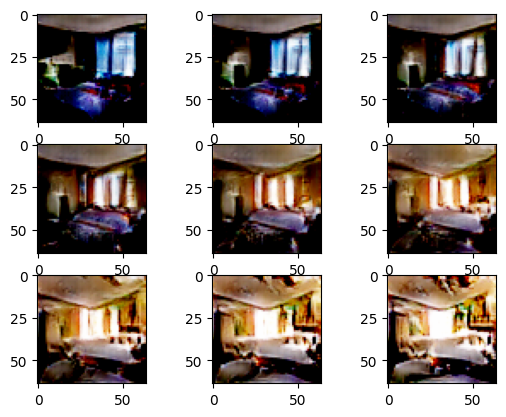

In [112]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3)
ax1.imshow(np.transpose(lerp_fake_images[0].cpu().detach().numpy(),(1,2,0)))
ax2.imshow(np.transpose(lerp_fake_images[1].cpu().detach().numpy(),(1,2,0)))
ax3.imshow(np.transpose(lerp_fake_images[2].cpu().detach().numpy(),(1,2,0)))
ax4.imshow(np.transpose(lerp_fake_images[3].cpu().detach().numpy(),(1,2,0)))
ax5.imshow(np.transpose(lerp_fake_images[4].cpu().detach().numpy(),(1,2,0)))
ax6.imshow(np.transpose(lerp_fake_images[5].cpu().detach().numpy(),(1,2,0)))
ax7.imshow(np.transpose(lerp_fake_images[6].cpu().detach().numpy(),(1,2,0)))
ax8.imshow(np.transpose(lerp_fake_images[7].cpu().detach().numpy(),(1,2,0)))
ax9.imshow(np.transpose(lerp_fake_images[8].cpu().detach().numpy(),(1,2,0)))